# **Puddle World**  

The "Puddle World" environment provides an interface for reinforcement learning experiments. It features puddles and challenges agents to navigate to specified goal positions while avoiding the puddles with larger negative rewards.
You can access key details like starting position, goal location, and action noise levels. By printing these attributes, you can gain insights into the environment's layout and develop strategies for training reinforcement learning algorithms effectively within the Puddle World domain.
Here is the default Puddle World configuration inspired by the [original paper](/http://incompleteideas.net/papers/sutton-96.pdf):

**Actions**

There are four actions: up, down, right, and left.
Each action moves approximately 0.05 in these directions. For the case where an action would take the agent out of the screen limits, the action does not move the agent instead.

A random gaussian noise with standard deviation 0.01 is also added to the motion along both dimensions.

**Reward**

The reward is -1 for each time step, plus some additional penalty if the agent gets into the puddle.
The penalty is -400 times the distance into the puddle (distance to the nearest edge).


**Puddle Positions**

The puddles's top-left position is [0.  , 0.85] and [0.35, 0.9] respectively, and the width and height for them is [0.55, 0.2 ] and [0.2, 0.6].

**Start Position**

The agent starts each episode at [0.2, 0.4].

**Goal Position**

The episode ends succesfully if the agent reaches [1.0, 1.0] which is the goal position.


In [ ]:
import gymnasium as gym
import gym_puddle

from stable_baselines3 import DQN
from stable_baselines3.dqn import MlpPolicy as DQNPolicy  # not sure why MlpPolicy is aliased as DQNPolicy

import time
import json

import matplotlib.pyplot as plt
import numpy as np

from IPython import display
import pyvirtualdisplay
import cv2 # ! pip install opencv-python

import torch
import optuna
from optuna import create_study
from typing import Any, Dict

import datetime
from stable_baselines3 import PPO

# !pip install git+https://github.com/Amii-Open-Source/gym-puddle.git
# !pip install pyvirtualdisplay

import pickle

c:\Users\ron_d\myenv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Here are the printed details about the environment.

In [ ]:
  env = gym.make("PuddleWorld-v0")

  print("start position:", env.get_wrapper_attr("start"))
  print("goal position:", env.get_wrapper_attr("goal"))
  print("goal threshold:", env.get_wrapper_attr("goal_threshold"))
  print("action noise:", env.get_wrapper_attr("noise"))
  print("agent's thrust:", env.get_wrapper_attr("thrust"))
  print("puddle top left positions:", env.get_wrapper_attr("puddle_top_left"))
  print("puddle widths and heights:", env.get_wrapper_attr("puddle_width"))
  print("action space:", env.get_wrapper_attr("actions"))
  print("observation space:", env.get_wrapper_attr("observation_space"))

start position: [0.2 0.4]
goal position: [1. 1.]
goal threshold: 0.1
action noise: 0.01
agent's thrust: 0.05
puddle top left positions: [array([0.  , 0.85]), array([0.35, 0.9 ])]
puddle widths and heights: [array([0.55, 0.2 ]), array([0.2, 0.6])]
action space: [array([-0.05,  0.  ]), array([0.05, 0.  ]), array([ 0.  , -0.05]), array([0.  , 0.05])]
observation space: Box(0.0, 1.0, (2,), float64)


Here is the visualization of the environment for the default configuration.

In [ ]:
#some functions to help the visualization and interaction with the environment

def visualize(frames, video_name = "video.mp4"):
    # Saves the frames as an mp4 video using cv2
    video_path = video_name
    height, width, _ = frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    video_writer = cv2.VideoWriter(video_path, fourcc, 30, (width, height))
    for frame in frames:
        video_writer.write(frame)
    video_writer.release()

def online_rendering(image):
    #Visualize one frame of the image in a display
    fig, ax = plt.subplots(figsize=(20, 20))                # new addition?
    ax.axis('off')
    img_with_frame = np.zeros((image.shape[0]+2, image.shape[1]+2, 3), dtype=np.uint8)
    img_with_frame[1:-1, 1:-1, :] = image
    ax.imshow(img_with_frame)
    display.display(plt.gcf())
    display.clear_output(wait=True)
    plt.show()


def prepare_display():
  #Prepares display for onine rendering of the frames in the game
  _display = pyvirtualdisplay.Display(visible=False,size=(1400, 900))
  _ = _display.start()
  fig, ax = plt.subplots(figsize=(5, 5))
  ax.axis('off')

In [ ]:
default_config = 'pw2.json'         # change this for the various files - I don't get why it's specified here when each file is called in `submit_this()`

  Cloning https://github.com/Amii-Open-Source/gym-puddle.git to /tmp/pip-req-build-xsii6efm
  Running command git clone --filter=blob:none --quiet https://github.com/Amii-Open-Source/gym-puddle.git /tmp/pip-req-build-xsii6efm
  Resolved https://github.com/Amii-Open-Source/gym-puddle.git to commit 7ddd0ec98bf476aa6ea116c3e7168986663166a1
  Preparing metadata (setup.py) ... done
======= Setup done


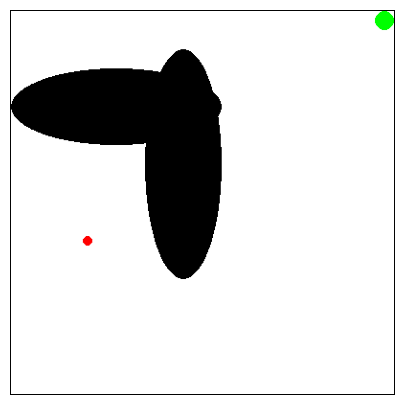

In [ ]:
obs, info = env.reset()
image = env.render()
fig, ax = plt.subplots(figsize=(5, 5))
online_rendering(image)

## 2.1 Accessing Different Environment Configurations

Your task is to train an agent that can generalize well across different provided configurations of the environment. Each of these configurations feature different positions for puddles, which makes it challenging for the agent to find the most rewarding path to the goal.


You can find these configurations in the `env_configs` folder of the repository. In order to access each version of the environment, you can provide the `.json` file indicating the environment details, and intitialize the puddle world as follows:
(Note that if you are using colab, you should upload the configs to the files section of the colab)
The puddle positions are different in these configurations, but other aspects of the environment remain the same.

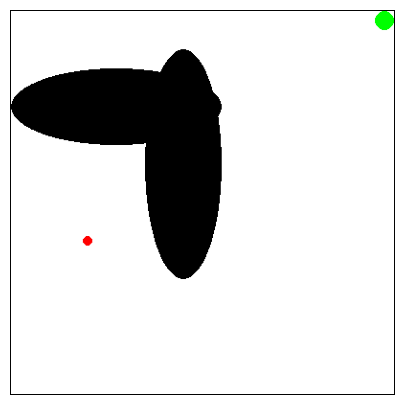

In [ ]:
json_file = f"gym_puddle/env_configs/pw1.json"        # working in VSCode, not colab or kaggle (colab's being difficult in file access anyway)
#json_file = f"/content/pw1.json"

with open(json_file) as f:
  env_setup = json.load(f)

env = gym.make(
  "PuddleWorld-v0",
  start=env_setup["start"],
  goal=env_setup["goal"],
  goal_threshold=env_setup["goal_threshold"],
  noise=env_setup["noise"],
  thrust=env_setup["thrust"],
  puddle_top_left=env_setup["puddle_top_left"],
  puddle_width=env_setup["puddle_width"],
)

obs, info = env.reset()
image = env.render()
fig, ax = plt.subplots(figsize=(5, 5))
online_rendering(image)

## Proximal Policy Optimization (PPO)  

#### Training with LR 0.80  

As it was set-up in a different notebook for trial purposes.

In [ ]:
#train the model, and save the trained model

print("==== Training ====", datetime.datetime.now())
env = gym.make("PuddleWorld-v0")
print("env.observation_space:",env.observation_space)
print("============")

ppo_model5 = PPO("MlpPolicy", env, verbose=1, learning_rate=0.80, gamma=0.95)  # changed LR from 0.99 to 0.95
ppo_model5.learn(total_timesteps=80000)
ppo_model5.save("ppo_model5")
print("==== Training Done", datetime.datetime.now())

==== Training ==== 2024-05-08 14:16:17.978558
env.observation_space: Box(0.0, 1.0, (2,), float64)
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
----------------------------------
| rollout/           |           |
|    ep_len_mean     | 936       |
|    ep_rew_mean     | -2.83e+04 |
| time/              |           |
|    fps             | 2102      |
|    iterations      | 1         |
|    time_elapsed    | 0         |
|    total_timesteps | 2048      |
----------------------------------
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 936       |
|    ep_rew_mean          | -2.83e+04 |
| time/                   |           |
|    fps                  | 1511      |
|    iterations           | 2         |
|    time_elapsed         | 2         |
|    total_timesteps      | 4096      |
| train/                  |           |
|    approx_kl            | 73.13058  |
|    clip_fraction

### To prep the training data for submission  

In [ ]:
def run_training(episodes, stfile):
  print("====================", datetime.datetime.now())

  json_file = f"gym_puddle/env_configs/{stfile}"
  #json_file = f"/content/pw1.json"

  with open(json_file) as f:
    env_setup = json.load(f)

#     json_file = f"/kaggle/input/content/{stfile}"
# #    print(json_file)
#     with open(json_file) as f:
#       env_setup = json.load(f)

    env = gym.make(
      "PuddleWorld-v0",
      start=env_setup["start"],
      goal=env_setup["goal"],
      goal_threshold=env_setup["goal_threshold"],
      noise=env_setup["noise"],
      thrust=env_setup["thrust"],
      puddle_top_left=env_setup["puddle_top_left"],
      puddle_width=env_setup["puddle_width"],
    )
#    env = gym.make('PuddleWorld-v0')

  ppo_model_submit = PPO("MlpPolicy", env, verbose=1, learning_rate=0.80, gamma=0.95)  
  ppo_model_submit.learn(total_timesteps=80000)
  ppo_model_submit.save("ppo_model_submit")

if __name__ == '__main__':
    run_training(15000, default_config)       # is this default_config going to be a problem?  I'm not sure why it's here if we call each json file in submit_this()

#### Testing  

As it was set-up in a different notebook for trial purposes.

In [ ]:
ppo_model5 = PPO.load("ppo_model5")
env = gym.make("PuddleWorld-v0")

# Create an empty list to store the frames
frames = []
episode_rewards = []
pactions = [0, 1, 2, 3]
for episode in range(300):
  total_reward = 0
  done = False
  num_steps = 0
  obs, info = env.reset()

  while not done and num_steps <=1000: # to avoid infinite loops for the untuned DQN we set a truncation limit, but you should make your agent sophisticated enough to avoid infinite-step episodes
      num_steps +=1
      action, _states = ppo_model5.predict(obs)
      obs, reward, done, trunc, info = env.step(action)
      print(num_steps,action,obs," reward:", reward," total reward:", total_reward)
      #print("obs:",obs,"reward:", reward,"done:", done,"trunc:", trunc,"info:", info)
      total_reward += reward
      if reward==0 : done = True
      # image = env.render()
      # frames.append(image)

      if done:
        print(f"total reward in this episode: {total_reward}"," Steps",num_steps)
        episode_rewards.append(total_reward)
        total_reward = 0
        break
  print(f"Not done: {total_reward}"," Steps",num_steps)

env.close()

if episode_rewards == []:
  print("no episode finished in this run.")
else:
  for i, reward in enumerate(episode_rewards):
    print(f"episode {i}: reward: {reward}")

#visualize(frames, "PPO.mp4")


1 1 [0.24061073 0.39906913]  reward: -1  total reward: 0
2 1 [0.30214432 0.4019376 ]  reward: -1  total reward: -1
3 1 [0.3561396  0.41857415]  reward: -192.5703415552626  total reward: -2
4 1 [0.39889808 0.42415771]  reward: -190.336916550181  total reward: -194.5703415552626
5 1 [0.44035091 0.44579815]  reward: -181.68073987599988  total reward: -384.9072581054436
6 1 [0.49237783 0.45442539]  reward: -178.22984506160557  total reward: -566.5879979814434
7 1 [0.5469028  0.44604493]  reward: -181.58202803520612  total reward: -744.817843043049
8 1 [0.60149908 0.43186585]  reward: -1  total reward: -926.3998710782552
9 1 [0.64600486 0.42421028]  reward: -1  total reward: -927.3998710782552
10 1 [0.69117683 0.43608581]  reward: -1  total reward: -928.3998710782552
11 1 [0.72124426 0.44857001]  reward: -1  total reward: -929.3998710782552
12 1 [0.78439509 0.45621095]  reward: -1  total reward: -930.3998710782552
13 1 [0.83729518 0.44677294]  reward: -1  total reward: -931.3998710782552
14

### To prep the testing data for submission  

In [ ]:
def run_submit(seed, stfile,cutline):
  print("====================", datetime.datetime.now())
  json_file = f"gym_puddle/env_configs/{stfile}"   
  
  with open(json_file) as f:
    env_setup = json.load(f)

    env = gym.make(
      "PuddleWorld-v0",
      start=env_setup["start"],
      goal=env_setup["goal"],
      goal_threshold=env_setup["goal_threshold"],
      noise=env_setup["noise"],
      thrust=env_setup["thrust"],
      puddle_top_left=env_setup["puddle_top_left"],
      puddle_width=env_setup["puddle_width"],
    )
    # f = open(stfile[0:3]+'-training20x20.pkl', 'rb')
    # q = pickle.load(f)
    # f.close()

    # we're loading a trained PPO model, not a q-table for this one
    ppo_model_submit = PPO.load("ppo_model_submit")

    obs, info = env.reset(seed = 2)       # Need to understand this seed thing... haven't had a chance to mull this at all.
    print("100 test walks of PuddleWorld-v0, made from",stfile, datetime.datetime.now())

# OK NOW HERE'S WHERE I NEED TO RECONCILE THE TESTING APPROACH TAKEN ABOVE, WITH WHAT'S DONE BELOW (OBV NOT USING A Q-TABLE) FOR THE PURPOSES OF PRODUCING WHAT'S REQUIRED
# FOR SUBMISSION.

    frames = []

    rewards_per_seed = np.zeros(seed)

    for i in range(seed):            # again... seed...
          location = env.reset()[0]  # states: 0 to 420, 0=top left corner,63=bottom right corner           # I thought it started on the bottom left... 
          state = round(location[0]*20)*20+round(location[1]*20)
          terminated = False      # True when fall in hole or reached goal
          truncated = False       # True when actions > 200
          totsteps = 0
          totrewards = 0

          while(not terminated and not truncated):
            # action = np.argmax(q[state,:])
            # new_location,reward,terminated,truncated,_ = env.step(action)
            # new_state = round(new_location[0]*20)*20+round(new_location[1]*20)
            # state = new_state
            totsteps = totsteps + 1
            totrewards = totrewards + reward
            if reward<-1:
#                print("Ug.. Hit Puddle after",totsteps,"steps")
                terminated = True                                     # you don't let it accumulate the scads of negative rewards and log that?
            if reward==0:
#                print("Success! after",totsteps,"steps")
                terminated = True
            if totsteps>200:
#                print("Truncated after",totsteps,"steps")
                truncated = True
            image = env.render()
          rewards_per_seed[i] = totrewards
    env.close()
    average = sum(rewards_per_seed) / len(rewards_per_seed)
    print("===", "rewards_per_seed average",average, " cutline",cutline)
    if average>-cutline : 
        episode_rewards_per_configuration.append(rewards_per_seed)
        print(rewards_per_seed)
    print("====================", datetime.datetime.now())
    return average

episode_rewards_per_configuration = []

## To prepare results  

==================== 2024-04-25 15:35:07.421079
PuddleWorld-v0, made from pw1.json
15000 searches of PuddleWorld-v0
==================== 2024-04-25 15:35:07.507996
Start position: [0.2 0.4]
 Goal position: [1. 1.]
Training now. One moment please ...
Tracking hits/100 over 15000 trys
Writing graph:pw1-training20x20.png
 Save Q-table:pw1-training20x20.pkl
==================== 2024-04-25 15:35:47.945933
==================== 2024-04-25 15:35:47.946502
100 test walks of PuddleWorld-v0, made from pw1.json 2024-04-25 15:35:48.030392
=== rewards_per_seed average -33.63  cutline 34
[-34. -34. -30. -33. -34. -33. -33. -34. -35. -35. -34. -35. -33. -35.
 -36. -33. -34. -35. -31. -34. -35. -33. -34. -32. -34. -35. -33. -35.
 -33. -35. -32. -32. -40. -36. -32. -34. -31. -37. -32. -34. -37. -30.
 -35. -35. -33. -33. -31. -33. -34. -34. -34. -34. -32. -30. -32. -29.
 -34. -38. -33. -33. -31. -33. -36. -32. -31. -36. -35. -34. -32. -32.
 -34. -29. -32. -37. -33. -34. -32. -31. -29. -37. -37. -34. -35.

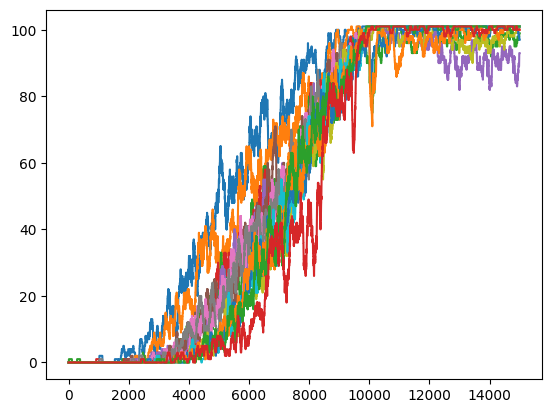

In [ ]:
def writecsv(episode_rewards_per_configuration):
    # Define the column names
    columns = ['seed_ID', 'ep_reward_pw1', 'ep_reward_pw2', 'ep_reward_pw3', 'ep_reward_pw4', 'ep_reward_pw5']
    data = []           # Create a list of dictionaries to store data  
    for episode_id in range(1, 101):  # Assuming 100 episodes
        row_data = {'seed_ID': episode_id}
        for i, rewards in enumerate(episode_rewards_per_configuration):
            row_data[columns[i + 1]] = rewards[episode_id - 1]
        data.append(row_data)

    import pandas as pd
    df = pd.DataFrame(data)               # Create DataFrame from the list of dictionaries
    csv_file_name = "submission.csv"      # Define the file name for saving the results
    df.to_csv(csv_file_name, index=False) # Save the DataFrame to a CSV file
    print("Results saved successfully to", csv_file_name)

    csv_file_name = "submission.csv"       # Define the file name for loading the results
    df = pd.read_csv(csv_file_name)        # Load the CSV file into a pandas DataFrame
    print(df)                              # Display the DataFrame
    
def submit_this(stfile, cutline):
    average=-100
    while average<-cutline : 
        run_training(default_training_episodes, stfile)
        average = run_submit(100, stfile, cutline)

if __name__ == '__main__':    
    default_training_episodes = 15000
    submit_this('pw1.json',34)
    submit_this('pw2.json',34)
    submit_this('pw3.json',30)
    submit_this('pw4.json',34)
    submit_this('pw5.json',37)
        
    writecsv(episode_rewards_per_configuration)
    print("------ all done ...")